# Chin Yang's Experiment

## Importing libraries

In [2]:
import os, mpld3
import glob
from os import listdir
import math
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.interpolate import UnivariateSpline
from scipy.signal import find_peaks, peak_prominences
import scipy.fftpack as sp
import json
from statistics import mean
from itertools import combinations, product
import pprint
import re
import time
from tqdm import tqdm
startTime = time.time()


%matplotlib inline
mpld3.enable_notebook()

## Retrieving Raw Motion Data

In [2]:
# getting current directory
cwd = os.getcwd()
print(cwd)
# testing folder directory
# df = pd.read_csv('Motion Data/ftap-lvl0-forearm_S2_2019-12-05T09.55.32.037_C49948A1895C_Accelerometer_1.4.5.csv')
# df
# folder = ('Motion Data/')

C:\Users\User\Desktop\4th_year_project\Parkinson-Disease-Repository\Testground\Test 3 - Chin Yang Playground


## Configuration Testing

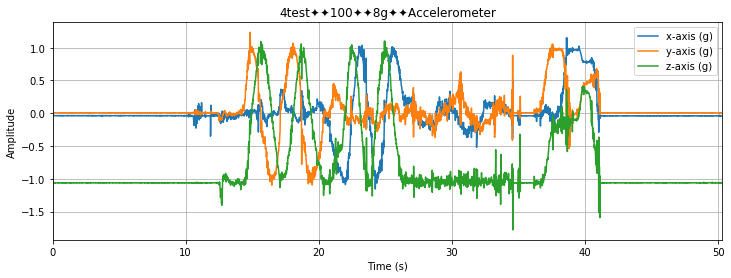

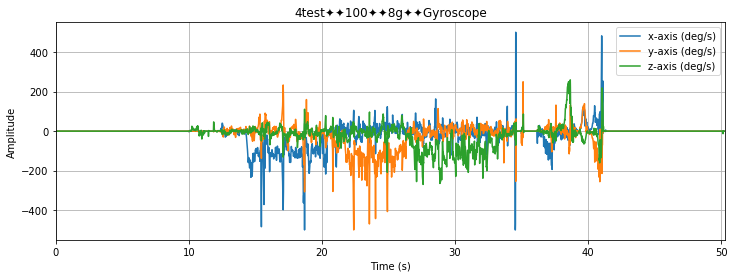

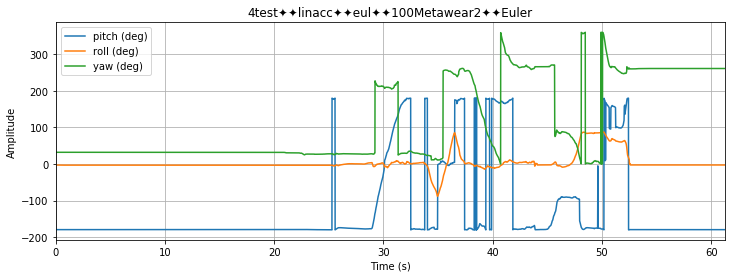

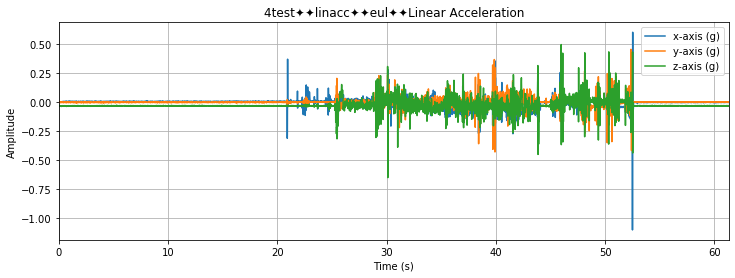

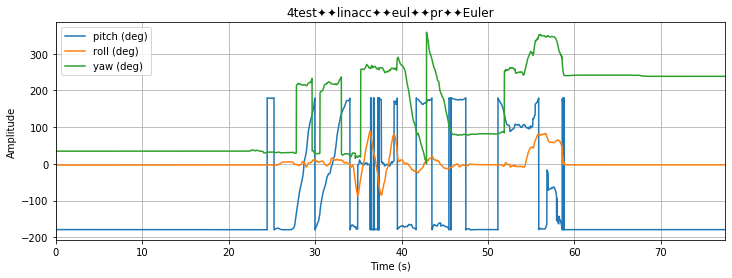

...

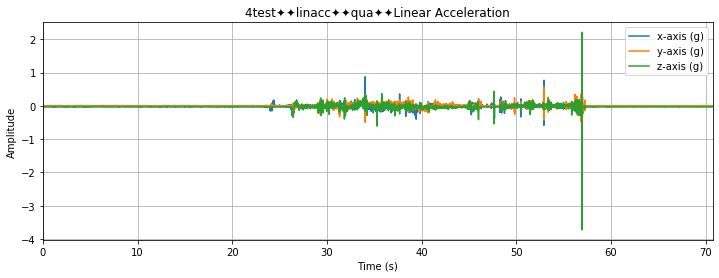

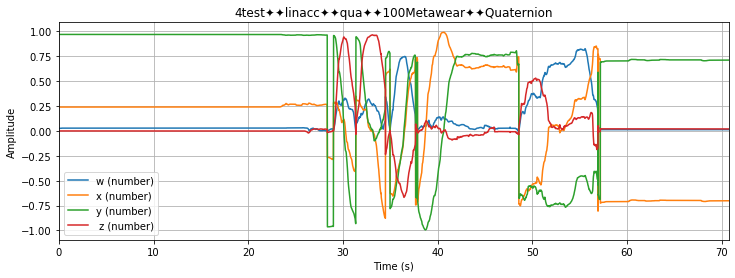

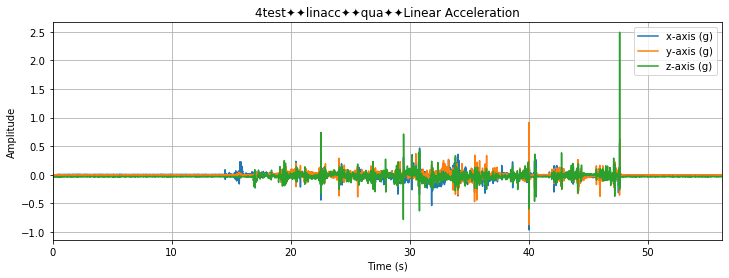

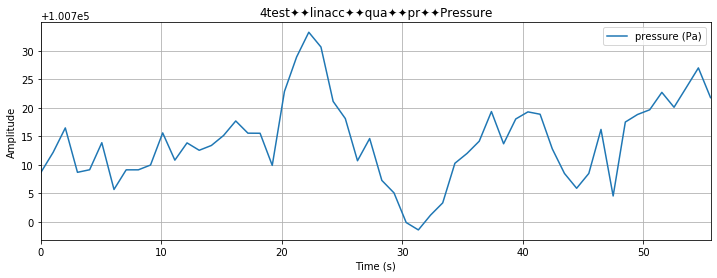

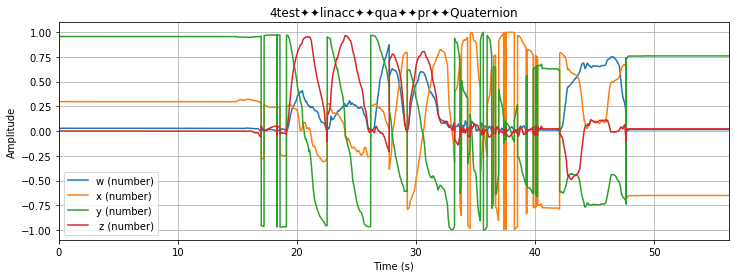

In [21]:
def configure():
    for testfile in glob.glob('PD_redo/*.csv'):
        if ('4test' in testfile):
            if True:
                if ('Accelerometer' in testfile):
                    df1 = pd.read_csv(testfile)
                    oldname = testfile[8:-64].replace('_','')
                    newname1 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Accelerometer'

                    ax = df1.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                  grid=True,figsize=(12,4), title=newname1)
                    ax.set_xlabel('Time (s)')
                    ax.set_ylabel('Amplitude')

                elif ('Gyroscope' in testfile):
                    df2 = pd.read_csv(testfile)
                    oldname = testfile[8:-59].replace('_','')
                    newname2 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Gyroscope'

                    ax = df2.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                 grid=True,figsize=(12,4), title=newname2)
                    ax.set_xlabel('Time (s)')
                    ax.set_ylabel('Amplitude')
                    
                elif ('Linear Acceleration' in testfile):
                    df3 = pd.read_csv(testfile)
                    oldname = testfile[8:-70].replace('_','')
                    newname1 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Linear Acceleration'

                    ax = df3.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                  grid=True,figsize=(12,4), title=newname1)
                    ax.set_xlabel('Time (s)')
                    ax.set_ylabel('Amplitude')
                    
                    
                elif ('Gravity' in testfile):
                    df4 = pd.read_csv(testfile)
                    oldname = testfile[8:-57].replace('_','')
                    newname1 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Gravity'

                    ax = df4.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                  grid=True,figsize=(12,4), title=newname1)
                    ax.set_xlabel('Time (s)')
                    ax.set_ylabel('Amplitude')
                
                    
                elif ('Quaternion' in testfile):
                    df5 = pd.read_csv(testfile)
                    oldname = testfile[8:-58].replace('_','')
                    newname2 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + oldname.split('-')[3] + '\u2726''\u2726' + 'Quaternion'
                    
                    ax = df5.plot(x='elapsed (s)', y=['w (number)','x (number)','y (number)', ' z (number)'], 
                                 grid=True,figsize=(12,4), title=newname2)
                    ax.set_xlabel('Time (s)')
                    ax.set_ylabel('Amplitude')
                    
                elif ('Euler' in testfile):
                    df6 = pd.read_csv(testfile)
                    oldname = testfile[8:-58].replace('_','')
                    newname2 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + oldname.split('-')[3] + '\u2726''\u2726' + 'Euler'
  
                    ax = df6.plot(x='elapsed (s)', y=['pitch (deg)','roll (deg)','yaw (deg)'], 
                                 grid=True,figsize=(12,4), title=newname2)
                    ax.set_xlabel('Time (s)')
                    ax.set_ylabel('Amplitude')
                    
                elif ('Pressure' in testfile):
                    df7 = pd.read_csv(testfile)
                    oldname = testfile[8:-58].replace('_','')
                    newname2 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + oldname.split('-')[3] + '\u2726''\u2726' + 'Pressure'
                    
                    ax = df7.plot(x='elapsed (s)', y=['pressure (Pa)'], 
                                 grid=True,figsize=(12,4), title=newname2)
                    ax.set_xlabel('Time (s)')
                    ax.set_ylabel('Amplitude')
                
                
                    
                    
                    

configure()


## Orientation Testing

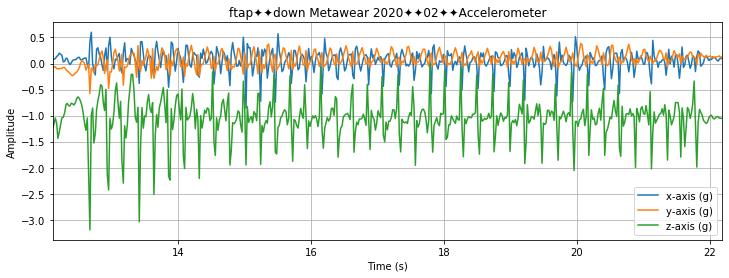

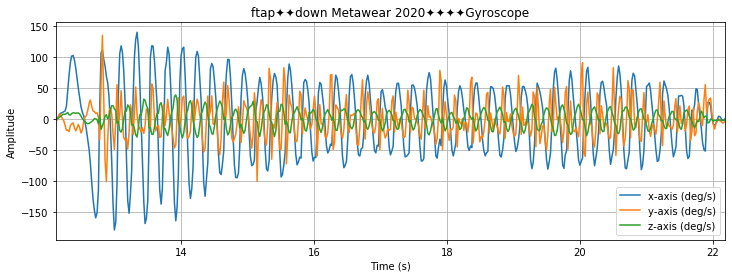

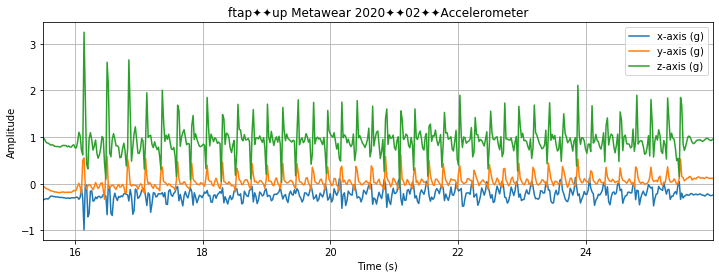

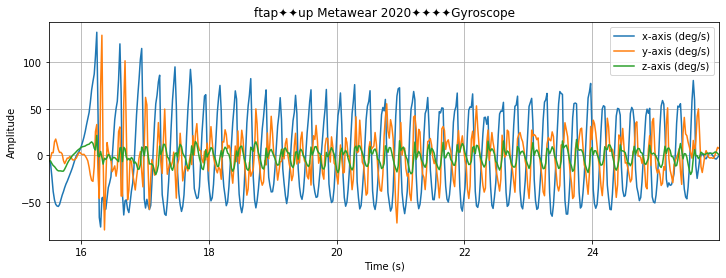

In [176]:
def orient():
    for testfile in glob.glob('PD_redo/*.csv'):
        if True:
            if ('Accelerometer' in testfile):
#                     oldname = testfile[8:-64].replace('_','')
                oldname = testfile[8:-51].replace('_',' ')
                newname1 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Accelerometer'
                if ('up_' in testfile):
                    dfff = pd.read_csv(testfile, engine='python')
                    trunc = dfff.loc[dfff['elapsed (s)'].between(15.5,26, inclusive=False)]
                    axes = trunc.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                  grid=True,figsize=(12,4), title=newname1)
                    axes.set_xlabel('Time (s)')
                    axes.set_ylabel('Amplitude')
                    
                elif ('down_' in testfile):
                    dfff = pd.read_csv(testfile, engine='python')
                    trunc = dfff.loc[dfff['elapsed (s)'].between(12.1,22.2, inclusive=False)]
                    axes = trunc.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                  grid=True,figsize=(12,4), title=newname1)
                    axes.set_xlabel('Time (s)')
                    axes.set_ylabel('Amplitude')

            elif ('Gyroscope' in testfile):
#                     oldname = testfile[8:-59].replace('_','')
                oldname = testfile[8:-51].replace('_',' ')
                newname2 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Gyroscope'
                if ('up_' in testfile):
                    dfff = pd.read_csv(testfile, engine='python')
                    trunc = dfff.loc[dfff['elapsed (s)'].between(15.5,26, inclusive=False)]
                    axes = trunc.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                 grid=True,figsize=(12,4), title=newname2)
                    axes.set_xlabel('Time (s)')
                    axes.set_ylabel('Amplitude')
                    
                elif ('down_' in testfile):
                    dfff = pd.read_csv(testfile, engine='python')
                    trunc = dfff.loc[dfff['elapsed (s)'].between(12.1,22.2, inclusive=False)]
                    axes = trunc.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                 grid=True,figsize=(12,4), title=newname2)
                    axes.set_xlabel('Time (s)')
                    axes.set_ylabel('Amplitude')
                    
                    
                    
orient()

In [112]:
def plot_exp():
    for testfile in glob.glob('Sara_experiment/*.csv'):
        if ('ftap' in testfile):
            if True:
                if ('Accelerometer' in testfile):
                    df1 = pd.read_csv(testfile)
                    oldname = testfile[16:-64].replace('_','')
#                     newname1 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Accelerometer'

                    ax1 = df1.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                  grid=True,figsize=(12,4), title=oldname+'--Acc')
                    ax1.set_xlabel('Time (s)')
                    ax1.set_ylabel('Amplitude')
                    
                    display(df1)
                    
                elif ('Gyroscope' in testfile):
                    df2 = pd.read_csv(testfile)
                    oldname = testfile[16:-59].replace('_','')
#                     newname2 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Gyroscope'

                    ax2 = df2.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                 grid=True,figsize=(12,4), title=oldname+'--Gyro')
                    ax2.set_xlabel('Time (s)')
                    ax2.set_ylabel('Amplitude')
                    
                    display(df2)

                elif ('Quaternion' in testfile):
                    df3 = pd.read_csv(testfile)
                    oldname = testfile[16:-65].replace('_','')
#                     newname2 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + oldname.split('-')[3] + '\u2726''\u2726' + 'Quaternion'
                    
                    ax3 = df3.plot(x='elapsed (s)', y=['w (number)','x (number)','y (number)', ' z (number)'], 
                                 grid=True,figsize=(12,4), title=oldname+'--Quat')
                    ax3.set_xlabel('Time (s)')
                    ax3.set_ylabel('Amplitude')
                    
                    display(df3)
                    
                elif ('Linear Acceleration' in testfile):
                    df4 = pd.read_csv(testfile)
                    oldname = testfile[16:-74].replace('_','')
#                     newname1 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Linear Acceleration'

                    ax4 = df4.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                  grid=True,figsize=(12,4), title=oldname+'--Linacc')
                    ax4.set_xlabel('Time (s)')
                    ax4.set_ylabel('Amplitude')
                    
                    display(df4)

# plot_exp()

## Time Series Data

,epoch (ms),time (-00:00),elapsed (s),x-axis (g),y-axis (g),z-axis (g)
0,1576841319009,2019-12-20T11:28:39.009,0.000,0.906,0.260,0.274
1,1576841319030,2019-12-20T11:28:39.030,0.021,0.931,0.281,0.283
2,1576841319049,2019-12-20T11:28:39.049,0.040,0.932,0.284,0.285
3,1576841319069,2019-12-20T11:28:39.069,0.060,0.932,0.257,0.292
4,1576841319088,2019-12-20T11:28:39.088,0.079,0.950,0.229,0.309
...,...,...,...,...,...,...
10586,1576841529405,2019-12-20T11:32:09.405,210.396,0.043,-0.012,0.961
10587,1576841529424,2019-12-20T11:32:09.424,210.415,0.040,-0.011,0.961
10588,1576841529444,2019-12-20T11:32:09.444,210.435,0.041,-0.011,0.965
10589,1576841529465,2019-12-20T11:32:09.465,210.456,0.042,-0.011,0.965


,epoch (ms),time (-00:00),elapsed (s),x-axis (deg/s),y-axis (deg/s),z-axis (deg/s)
0,1576841318910,2019-12-20T11:28:38.910,0.000,5.877,-8.300,4.116
1,1576841318930,2019-12-20T11:28:38.930,0.020,6.136,-8.521,3.369
2,1576841318949,2019-12-20T11:28:38.949,0.039,5.473,-7.835,2.729
3,1576841318970,2019-12-20T11:28:38.970,0.060,3.643,-6.220,3.514
4,1576841318990,2019-12-20T11:28:38.990,0.080,1.387,-10.297,5.716
...,...,...,...,...,...,...
10591,1576841529405,2019-12-20T11:32:09.405,210.495,0.572,0.152,-0.259
10592,1576841529424,2019-12-20T11:32:09.424,210.514,0.663,0.191,-0.244
10593,1576841529444,2019-12-20T11:32:09.444,210.534,0.625,0.107,-0.259
10594,1576841529465,2019-12-20T11:32:09.465,210.555,0.625,0.183,-0.191


,epoch (ms),time (-00:00),elapsed (s),x-axis (g),y-axis (g),z-axis (g)
0,1576838556693,2019-12-20T10:42:36.693,0.000,0.414,-0.171,0.861
1,1576838556712,2019-12-20T10:42:36.712,0.019,0.409,-0.115,0.851
2,1576838556733,2019-12-20T10:42:36.733,0.040,0.381,-0.128,0.731
3,1576838556752,2019-12-20T10:42:36.752,0.059,0.416,-0.126,0.709
4,1576838556772,2019-12-20T10:42:36.772,0.079,0.456,-0.096,0.766
...,...,...,...,...,...,...
8568,1576838726978,2019-12-20T10:45:26.978,170.285,-0.729,-0.815,0.637
8569,1576838726997,2019-12-20T10:45:26.997,170.304,-0.484,-0.769,0.646
8570,1576838727018,2019-12-20T10:45:27.018,170.325,0.025,-0.967,0.558
8571,1576838727038,2019-12-20T10:45:27.038,170.345,-0.312,-0.666,0.604


,epoch (ms),time (-00:00),elapsed (s),x-axis (deg/s),y-axis (deg/s),z-axis (deg/s)
0,1576838556573,2019-12-20T10:42:36.573,0.000,-17.561,-55.175,-62.515
1,1576838556594,2019-12-20T10:42:36.594,0.021,-17.752,-56.303,-61.791
2,1576838556613,2019-12-20T10:42:36.613,0.040,-22.942,-67.188,-61.296
3,1576838556633,2019-12-20T10:42:36.633,0.060,-28.742,-80.823,-60.709
4,1576838556654,2019-12-20T10:42:36.654,0.081,-29.901,-69.794,-67.210
...,...,...,...,...,...,...
8574,1576838726978,2019-12-20T10:45:26.978,170.405,88.887,-174.977,-99.604
8575,1576838726997,2019-12-20T10:45:26.997,170.424,67.698,-161.037,-46.890
8576,1576838727018,2019-12-20T10:45:27.018,170.445,123.819,-197.942,42.843
8577,1576838727038,2019-12-20T10:45:27.038,170.465,230.137,-211.997,166.982


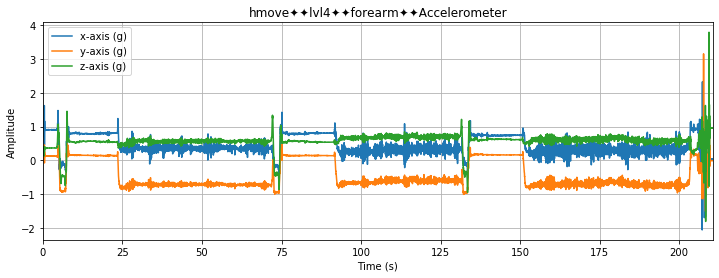

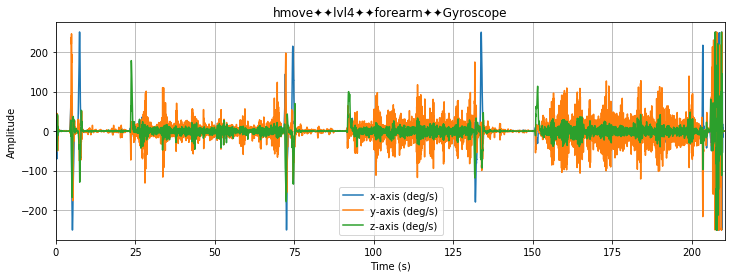

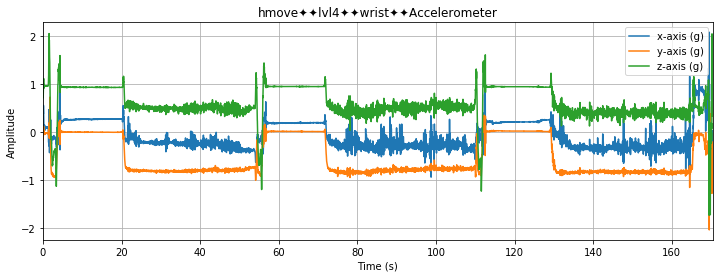

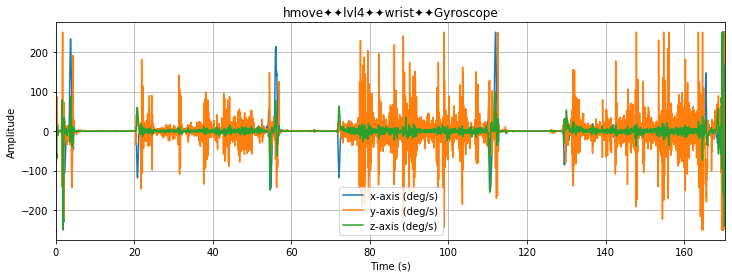

In [39]:
# def find_csv(folder, suffix=".csv"):
#     filenames = listdir(folder)
#     return [filename for filename in filenames if filename.endswith(suffix)]

# print(*find_csv(folder), sep ='\n')

# def csv():
#     for name in glob.glob('Motion Data/*'):
#         print (name) 
# csv()

def plot_raw():
    for name in glob.glob('Motion Data/*.csv'):
        if ('hmove' in name) and ('lvl4' in name):
            if True:
                if ('Accelerometer' in name):
                    df1 = pd.read_csv(name)
                    oldname = name[12:-64].replace('_','')
                    newname1 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Accelerometer'

                    ax1 = df1.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                  grid=True,figsize=(12,4), title=newname1)
                    ax1.set_xlabel('Time (s)')
                    ax1.set_ylabel('Amplitude')
                    
                    display(df1)
                    
                elif ('Gyroscope' in name):
                    df2 = pd.read_csv(name)
                    oldname = name[12:-59].replace('_','')
                    newname2 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Gyroscope'

                    ax2 = df2.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                 grid=True,figsize=(12,4), title=newname2)
                    ax2.set_xlabel('Time (s)')
                    ax2.set_ylabel('Amplitude')
                    
                    display(df2)

                    

plot_raw()



## Truncating Data


In [4]:
# # dataframes = []
# # for file_ in glob.glob('Motion Data/*.csv'):
# #     df = pd.read_csv(file_,index_col=None, header=0)
# #     dataframes.append(df)
# # # print(dataframes)

def trunc(): 
    string = input()
    position = input()
    lvl = input()
    s = string
    p = position
    l = lvl
    
    if s == 'ftap':
        if p == 'forearm' and l == 'lvl0':
            a,b,c,d,e,f = 22.7,34,50.4,62,78,89
            
        elif p == 'wrist' and l == 'lvl0':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'forearm' and l == 'lvl1':
            a,b,c,d,e,f = 20.5,32,54,65,86,97.5
            
        elif p == 'wrist' and l == 'lvl1':
            a,b,c,d,e,f = 25,38,62,73,94.3,106
        
        elif p == 'forearm' and l == 'lvl2':
            a,b,c,d,e,f =  26.2,37,58.5,70.5,91.5,103
        
        elif p == 'wrist' and l == 'lvl2':
            a,b,c,d,e,f = 25.1,35.75,61,72.25,95.25,106
        
        elif p == 'forearm' and l == 'lvl3':
            a,b,c,d,e,f = 23,35.8,57.8,70.9,94,107
            
        elif p == 'wrist' and l == 'lvl3':
            a,b,c,d,e,f = 26.5,38.4,61.5,76.1,97.75,110.5
            
        elif p == 'forearm' and l == 'lvl4':
            a,b,c,d,e,f = 19.9,33.2,52.8,64.6,85.9,100
        
        elif p == 'wrist' and l == 'lvl4':
            a,b,c,d,e,f = 21.4,38.1,60,72.3,91.5,103
        
    elif s == 'hmove':
        if p == 'forearm' and l == 'lvl0':
            a,b,c,d,e,f = 23,30,51.5,59,79.5,87
            
        elif p == 'wrist' and l == 'lvl0':
            a,b,c,d,e,f = 22,29,50,58.5,79,87.8
            
        elif p == 'forearm' and l == 'lvl1':
            a,b,c,d,e,f = 24.5,35.3,56.3,71.25,90.3,104
            
        elif p == 'wrist' and l == 'lvl1':
            a,b,c,d,e,f = 23.9,33.5,54.5,65.3,82,97
        
        elif p == 'forearm' and l == 'lvl2':
            a,b,c,d,e,f = 26.15,47,70.1,99.8,122.2,148.8
        
        elif p == 'wrist' and l == 'lvl2':
            a,b,c,d,e,f = 22.1,37.8,56.8,72,92.8,111.8
        
        elif p == 'forearm' and l == 'lvl3':
            a,b,c,d,e,f = 23.5,54.9,75.55,110,130.5,165.3
            
        elif p == 'wrist' and l == 'lvl3':
            a,b,c,d,e,f = 23.8,58.7,79.5,113,134,175.8
            
        elif p == 'forearm' and l == 'lvl4':
            a,b,c,d,e,f = 23.35,71,91.65,131.57,150.64,203.2
        
        elif p == 'wrist' and l == 'lvl4':
            a,b,c,d,e,f = 20.3,54.7,71.8,110.7,129.2,168.3
            
    elif s == 'prosup':
        if p == 'forearm' and l == 'lvl0':
            a,b,c,d,e,f = 22.7,34,50.4,62,78,89
            
        elif p == 'wrist' and l == 'lvl0':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
        
        elif p == 'forearm' and l == 'lvl1':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'wrist' and l == 'lvl1':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
        
        elif p == 'forearm' and l == 'lvl2':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
        
        elif p == 'wrist' and l == 'lvl2':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
        
        elif p == 'forearm' and l == 'lvl3':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'wrist' and l == 'lvl3':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'forearm' and l == 'lvl4':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
        
        elif p == 'wrist' and l == 'lvl4':
            a,b,c,d,e,f = 36,46,68,78.8,95,106

    elif s == 'ttap':
        if p == 'forearm' and l == 'lvl0':
            a,b,c,d,e,f = 22.7,34,50.4,62,78,89
            
        elif p == 'wrist' and l == 'lvl0':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
        
        elif p == 'forearm' and l == 'lvl1':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'wrist' and l == 'lvl1':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
        
        elif p == 'forearm' and l == 'lvl2':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
        
        elif p == 'wrist' and l == 'lvl2':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
        
        elif p == 'forearm' and l == 'lvl3':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'wrist' and l == 'lvl3':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'forearm' and l == 'lvl4':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
        
        elif p == 'wrist' and l == 'lvl4':
            a,b,c,d,e,f = 36,46,68,78.8,95,106

    elif s == 'leag':
        if p == 'calf&heel' and l == 'lvl0':
            a,b,c,d,e,f = 10,18.1,25.2,32.1,39.2,45.5
            
        elif p == '-heel_' and l == 'lvl0':
            a,b,c,d,e,f = 12.9,18.8,28.9,35.6,43.3,49.5
            
#             wrong
        elif p == 'calf&heel' and l == 'lvl1':
            a,b,c,d,e,f = 22.7,34,24.5,32.8,78,89
            
        elif p == '-heel_' and l == 'lvl1':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
#             wrong

        elif p == 'calf&heel' and l == 'lvl2':
            a,b,c,d,e,f = 11.2,24,29.9,40.8,46.8,65
            
        elif p == '-heel_' and l == 'lvl2':
            a,b,c,d,e,f = 9.75,22.5,28.7,39,45.5,55
            
        elif p == 'calf&heel' and l == 'lvl3':
            a,b,c,d,e,f = 9.8,25,32,44.8,52,66.6
            
        elif p == '-heel_' and l == 'lvl3':
            a,b,c,d,e,f = 10.8,25,32,49.8,55.8,73.5
            
        elif p == 'calf&heel' and l == 'lvl4':
            a,b,c,d,e,f = 8.5,23.8,30,45,52,67
            
        elif p == '-heel_' and l == 'lvl4':
            a,b,c,d,e,f = 9.2,31,36.8,57.8,64,75.6

    elif s == 'tota':
        if p == 'calf&heel' and l == 'lvl0':
            a,b,c,d,e,f = 17,23.87,31.9,39.42,47.42,55.4
            
        elif p == '-heel_' and l == 'lvl0':
            a,b,c,d,e,f = 14.8,26.74,37,44.5,51.38,58.2
            
        elif p == 'calf&heel' and l == 'lvl1':
            a,b,c,d,e,f = 9,16.86,24.5,32.8,38.91,47.9
            
        elif p == '-heel_' and l == 'lvl1':
            a,b,c,d,e,f = 9.88,20.6,28.74,40,49.8,61
            
        elif p == 'calf&heel' and l == 'lvl2':
            a,b,c,d,e,f = 23.9,31.7,38.79,50.7,57.7,68.5
            
        elif p == '-heel_' and l == 'lvl2':
            a,b,c,d,e,f = 13.6,28.8,35.65,47.07,54,65
            
        elif p == 'calf&heel' and l == 'lvl3':
            a,b,c,d,e,f = 8,28.75,35.88,52,58.27,74
            
        elif p == '-heel_' and l == 'lvl3':
            a,b,c,d,e,f = 7.8,23.74,30.77,44.12,50.8,62.95
            
        elif p == 'calf&heel' and l == 'lvl4':
            a,b,c,d,e,f = 9.7,31.8,39,51.94,58.85,79.6 
            
        elif p == '-heel_' and l == 'lvl4':
            a,b,c,d,e,f = 10,29.08,36,52.25,58.6,81.8

    elif s == 'tugt':
        if p == 'heel' and l == 'lvl0':
            a,b,c,d,e,f = 22.7,34,50.4,62,78,89
            
        elif p == 'waist' and l == 'lvl0':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'heel' and l == 'lvl1':
            a,b,c,d,e,f = 22.7,34,50.4,62,78,89
            
        elif p == 'waist' and l == 'lvl1':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'heel' and l == 'lvl2':
            a,b,c,d,e,f = 22.7,34,50.4,62,78,89
            
        elif p == 'waist' and l == 'lvl2':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'heel' and l == 'lvl3':
            a,b,c,d,e,f = 22.7,34,50.4,62,78,89
            
        elif p == 'waist' and l == 'lvl3':
            a,b,c,d,e,f = 36,46,68,78.8,95,106
            
        elif p == 'heel' and l == 'lvl4':
            a,b,c,d,e,f = 22.7,34,50.4,62,78,89
            
        elif p == 'waist' and l == 'lvl4':
            a,b,c,d,e,f = 36,46,68,78.8,95,106

    return s,p,l,a,b,c,d,e,f

ftap
forearm
lvl0


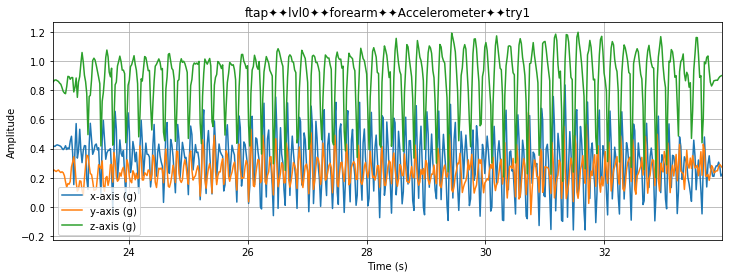

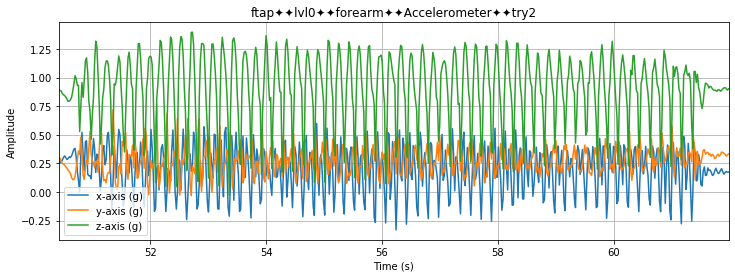

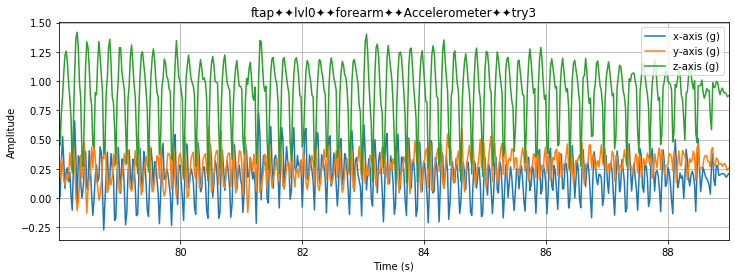

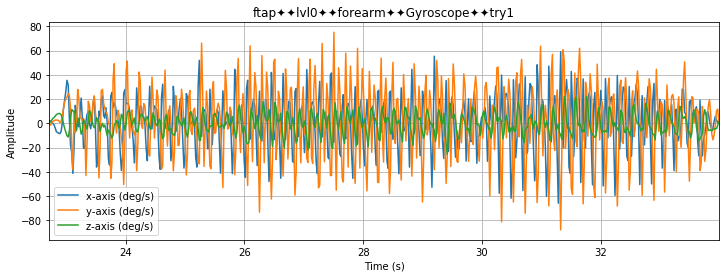

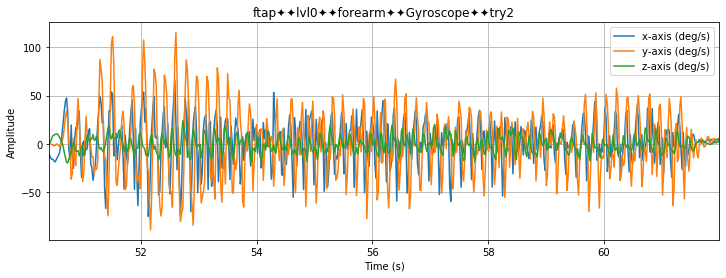

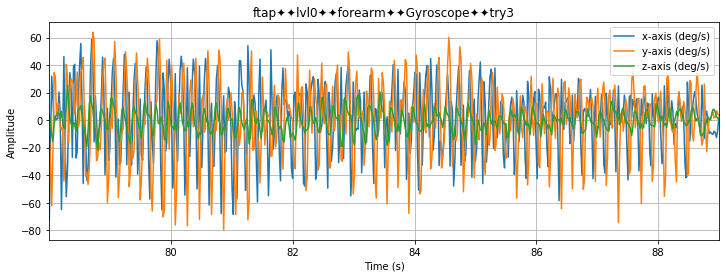

In [114]:
def new_time():
    string,position,lvl,num1,num2,num3,num4,num5,num6 = trunc()
    
    for name in glob.glob('Motion Data/*.csv'):
        if (string in name):
            if (position in name) and (lvl in name):
                if True:
                    if ('Accelerometer' in name):
                        df = pd.read_csv(name)

                        t1,t2,t3 = df.loc[df['elapsed (s)'].between(num1,num2, inclusive=False)],df.loc[df['elapsed (s)'].between(num3,num4, inclusive=False)],df.loc[df['elapsed (s)'].between(num5,num6, inclusive=False)]
                        
                        oldname = name[12:-64].replace('_','')
                        newname1 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Accelerometer'
                        
                        ax1 = t1.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                      grid=True,figsize=(12,4), title=newname1+'\u2726''\u2726'+'try1')
                        ax1.set_xlabel('Time (s)')
                        ax1.set_ylabel('Amplitude')
                        
                        ax2 = t2.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                      grid=True,figsize=(12,4), title=newname1+'\u2726''\u2726'+'try2')
                        ax2.set_xlabel('Time (s)')
                        ax2.set_ylabel('Amplitude')
                        
                        ax3 = t3.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                      grid=True,figsize=(12,4), title=newname1+'\u2726''\u2726'+'try3')
                        ax3.set_xlabel('Time (s)')
                        ax3.set_ylabel('Amplitude')
                        
                    elif ('Gyroscope' in name):
                        df = pd.read_csv(name)
                          
                        t4,t5,t6 = df.loc[df['elapsed (s)'].between(num1,num2, inclusive=False)],df.loc[df['elapsed (s)'].between(num3,num4, inclusive=False)],df.loc[df['elapsed (s)'].between(num5,num6, inclusive=False)]
                        
                        oldname = name[12:-59].replace('_','')
                        newname2 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Gyroscope'

                        ax1 = t4.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                     grid=True,figsize=(12,4), title=newname2+'\u2726''\u2726'+'try1')
                        ax1.set_xlabel('Time (s)')
                        ax1.set_ylabel('Amplitude')
                        
                        ax2 = t5.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                      grid=True,figsize=(12,4), title=newname2+'\u2726''\u2726'+'try2')
                        ax2.set_xlabel('Time (s)')
                        ax2.set_ylabel('Amplitude')
                        
                        ax3 = t6.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                      grid=True,figsize=(12,4), title=newname2+'\u2726''\u2726'+'try3')
                        ax3.set_xlabel('Time (s)')
                        ax3.set_ylabel('Amplitude')
                        
                        return t1,t2,t3,t4,t5,t6

t1,t2,t3,t4,t5,t6 = new_time()

In [309]:
def timestat():
    
    acc_t = [t1,t2,t3]
    gyro_t = [t4,t5,t6]
    appended1 = []
    appended2 = []
    appended3 = []
    appended4 =[]
    Lx = []
    Ly = []
    Lz = []
    L_x = []
    L_y = []
    L_z = []
    leng = []
    
    for t in acc_t:
        # appending number of zero crossing
        L1 = t['x-axis (g)'].values.tolist()
        ar_x = np.array(L1)
        zcross_xa = ((ar_x[:-1] * ar_x[1:]) < 0).sum()
       
        L2 = t['y-axis (g)'].values.tolist()
        ar_y = np.array(L2)
        zcross_ya = ((ar_y[:-1] * ar_y[1:]) < 0).sum()
        
        L3 = t['z-axis (g)'].values.tolist()
        ar_z = np.array(L3)
        zcross_za = ((ar_z[:-1] * ar_z[1:]) < 0).sum()
        
        # calculating mean and standard deviation values
        mewx_a=mean(L1)
        stdx_a=np.std(L1)
        mewy_a=mean(L2)
        stdy_a=np.std(L2)
        mewz_a=mean(L3)
        stdz_a=np.std(L3)
        
        Lx.append(ar_x)
        Ly.append(ar_y)
        Lz.append(ar_z)
        leng.append(len(L1))
        appended1.append([zcross_xa, zcross_ya, zcross_za])
        appended1.append([mewx_a, mewy_a, mewz_a])
        appended1.append([stdx_a, stdy_a, stdz_a])
        
        # appending number of mean crossing
        xcrossings_a = []
        for i in range(1, len(ar_x)):
            if ar_x[i-1] < mewx_a and ar_x[i] >= mewx_a:
                xcrossings_a.append(i)
        ycrossings_a = []
        for i in range(1, len(ar_y)):
            if ar_y[i-1] < mewy_a and ar_y[i] >= mewy_a:
                ycrossings_a.append(i)
        zcrossings_a = []
        for i in range(1, len(ar_z)):
            if ar_z[i-1] < mewz_a and ar_z[i] >= mewz_a:
                zcrossings_a.append(i)
                
        appended1.append([len(xcrossings_a), len(ycrossings_a), len(zcrossings_a)])
    
    # calculating covariance
    for i in range(len(Lx)):
        # setting conditions to deducting corresponding mean values from the array of different tries
        if len(Lx[i]) == len(Lx[0]):
            Lxi = Lx[i] - appended1[1][0]
            Lyi = Ly[i] - appended1[1][1]
            Lzi = Lz[i] - appended1[1][2]
        
        elif len(Lx[i]) == len(Lx[1]):
            Lxi = Lx[i] - appended1[5][0]
            Lyi = Ly[i] - appended1[5][1]
            Lzi = Lz[i] - appended1[5][2]
            
        elif len(Lx[i]) == len(Lx[2]):
            Lxi = Lx[i] - appended1[9][0]
            Lyi = Ly[i] - appended1[9][1]
            Lzi = Lz[i] - appended1[9][2]
            
        # using combination to calculate SOP of values divided by the number of values
        for i in combinations([Lxi,Lyi,Lzi],2):
#             display(pd.DataFrame(i))
            for x,y in [i]:
#                 display(pd.DataFrame(x*y))
                if len(Lxi) == leng[0]:
                    appended3.append(sum(x*y)/(leng[0]-1))

                elif len(Lxi) == leng[1]:
                    appended3.append(sum(x*y)/(leng[1]-1))

                elif len(Lxi) == leng[2]:
                    appended3.append(sum(x*y)/(leng[2]-1))
    
    # tabulating all statistics
    timestats1 = {'Zero-crossing rate':[appended1[0][0], appended1[4][0], appended1[8][0]],
            'Mean (g)':[appended1[1][0], appended1[5][0], appended1[9][0]],
            'Standard Deviations':[appended1[2][0], appended1[6][0], appended1[10][0]],
            'Mean-crossing rate':[appended1[3][0], appended1[7][0], appended1[11][0]]}   
    timestats1_df = pd.DataFrame(timestats1, index=[['x','x','x'],['try1','try2','try3']])

    timestats2 = {'Zero-crossing rate':[appended1[0][1], appended1[4][1], appended1[8][1]],
                'Mean (g)':[appended1[1][1], appended1[5][1], appended1[9][1]],
                'Standard Deviations':[appended1[2][1], appended1[6][1], appended1[10][1]],
                'Mean-crossing rate':[appended1[3][1], appended1[7][1], appended1[11][1]]}   
    timestats2_df = pd.DataFrame(timestats2,index=[['y','y','y'],['try1','try2','try3']])

    timestats3 = {'Zero-crossing rate':[appended1[0][2], appended1[4][2], appended1[8][2]],
                'Mean (g)':[appended1[1][2], appended1[5][2], appended1[9][2]],
                'Standard Deviations':[appended1[2][2], appended1[6][2], appended1[10][2]],
                'Mean-crossing rate':[appended1[3][2], appended1[7][2], appended1[11][2]]}   
    timestats3_df = pd.DataFrame(timestats3,index=[['z','z','z'],['try1','try2','try3']])
    
    covstats1 = {'Covariance':[appended3[0], appended3[3], appended3[6]]}
    
    covstats1_df = pd.DataFrame(covstats1,index=[['xy','xy','xy'],['try1','try2','try3']])
    
    covstats2 = {'Covariance':[appended3[1], appended3[4], appended3[7]]}
    covstats2_df = pd.DataFrame(covstats2,index=[['xz','xz','xz'],['try1','try2','try3']])
    
    covstats3 = {'Covariance':[appended3[2], appended3[5], appended3[8]]}
    
    covstats3_df = pd.DataFrame(covstats3,index=[['yz','yz','yz'],['try1','try2','try3']])
    
    acc_df1 = (timestats1_df.append(timestats2_df)).append(timestats3_df)
    acc_df2 = (covstats1_df.append(covstats2_df)).append(covstats3_df)
    
             
    for t in gyro_t:
        L4 = t['x-axis (deg/s)'].values.tolist()
        ar_x = np.array(L4)
        zcross_xg = ((ar_x[:-1] * ar_x[1:]) < 0).sum()
        
        L5 = t['y-axis (deg/s)'].values.tolist()
        ar_y = np.array(L5)
        zcross_yg = ((ar_y[:-1] * ar_y[1:]) < 0).sum()
        
        L6 = t['z-axis (deg/s)'].values.tolist()
        ar_z = np.array(L6)
        zcross_zg = ((ar_z[:-1] * ar_z[1:]) < 0).sum()

        mewx_g=mean(L4)
        stdx_g=np.std(L4)
        mewy_g=mean(L5)
        stdy_g=np.std(L5)
        mewz_g=mean(L6)
        stdz_g=np.std(L6)
        
        L_x.append(ar_x)
        L_y.append(ar_y)
        L_z.append(ar_z)
        appended2.append([zcross_xg, zcross_yg, zcross_zg])
        appended2.append([mewx_g, mewy_g, mewz_g])
        appended2.append([stdx_g, stdy_g, stdz_g])
        
        xcrossings_g = []
        for i in range(1, len(ar_x)):
            if ar_x[i-1] < mewx_g and ar_x[i] >= mewx_g:
                xcrossings_g.append(i)
        ycrossings_g = []
        for i in range(1, len(ar_y)):
            if ar_y[i-1] < mewy_g and ar_y[i] >= mewy_g:
                ycrossings_g.append(i)
        zcrossings_g = []
        for i in range(1, len(ar_z)):
            if ar_z[i-1] < mewz_g and ar_z[i] >= mewz_g:
                zcrossings_g.append(i)
                
        appended2.append([len(xcrossings_g), len(ycrossings_g), len(zcrossings_g)])
        
    for i in range(len(L_x)):
        if len(L_x[i]) == len(L_x[0]):
            Lxi = L_x[i] - appended2[1][0]
            Lyi = L_y[i] - appended2[1][1]
            Lzi = L_z[i] - appended2[1][2]
        
        elif len(L_x[i]) == len(L_x[1]):
            Lxi = L_x[i] - appended2[5][0]
            Lyi = L_y[i] - appended2[5][1]
            Lzi = L_z[i] - appended2[5][2]
            
        elif len(L_x[i]) == len(L_x[2]):
            Lxi = L_x[i] - appended2[9][0]
            Lyi = L_y[i] - appended2[9][1]
            Lzi = L_z[i] - appended2[9][2]
            

        for i in combinations([Lxi,Lyi,Lzi],2):
#             display(pd.DataFrame(i))
            for x,y in [i]:
#                 display(pd.DataFrame(x*y))
                if len(Lxi) == leng[0]:
                    appended4.append(sum(x*y)/(leng[0]-1))

                elif len(Lxi) == leng[1]:
                    appended4.append(sum(x*y)/(leng[1]-1))

                elif len(Lxi) == leng[2]:
                    appended4.append(sum(x*y)/(leng[2]-1))
                    
    timestats4 = {'Zero-crossing rate':[appended2[0][0], appended2[4][0], appended2[8][0]],
            'Mean (deg/s)':[appended2[1][0], appended2[5][0], appended2[9][0]],
            'Standard Deviations':[appended2[2][0], appended2[6][0], appended2[10][0]],
            'Mean-crossing rate':[appended2[3][0], appended2[7][0], appended2[11][0]]}   
    timestats4_df = pd.DataFrame(timestats4, index=[['x','x','x'],['try1','try2','try3']])
    
    timestats5 = {'Zero-crossing rate':[appended2[0][1], appended2[4][1], appended2[8][1]],
                'Mean (deg/s)':[appended2[1][1], appended2[5][1], appended2[9][1]],
                'Standard Deviations':[appended2[2][1], appended2[6][1], appended2[10][1]],
                'Mean-crossing rate':[appended2[3][1], appended2[7][1], appended2[11][1]]}   
    timestats5_df = pd.DataFrame(timestats5,index=[['y','y','y'],['try1','try2','try3']])
    
    timestats6 = {'Zero-crossing rate':[appended2[0][2], appended2[4][2], appended2[8][2]],
                'Mean (deg/s)':[appended2[1][2], appended2[5][2], appended2[9][2]],
                'Standard Deviations':[appended2[2][2], appended2[6][2], appended2[10][2]],
                'Mean-crossing rate':[appended2[3][2], appended2[7][2], appended2[11][2]]}   
    timestats6_df = pd.DataFrame(timestats6,index=[['z','z','z'],['try1','try2','try3']])
    
    covstats4 = {'Covariance':[appended4[0], appended4[3], appended4[6]]}
    
    covstats4_df = pd.DataFrame(covstats4,index=[['xy','xy','xy'],['try1','try2','try3']])
    
    covstats5 = {'Covariance':[appended4[1], appended4[4], appended4[7]]}
    covstats5_df = pd.DataFrame(covstats5,index=[['xz','xz','xz'],['try1','try2','try3']])
    
    covstats6 = {'Covariance':[appended4[2], appended4[5], appended4[8]]}
    
    covstats6_df = pd.DataFrame(covstats6,index=[['yz','yz','yz'],['try1','try2','try3']])

    gyro_df1 = (timestats4_df.append(timestats5_df)).append(timestats6_df)
    gyro_df2 = (covstats4_df.append(covstats5_df)).append(covstats6_df)
    
    display(acc_df1,acc_df2,gyro_df1,gyro_df2)

    return Lx,Ly,Lz,L_x,L_y,L_z,leng,appended1,appended2

Lx,Ly,Lz,L_x,L_y,L_z,leng,appended1,appended2 = timestat()



# Unable to loop through calculation of Pearson's coefficient at the moment. Standard Devation product problem, should work out soon


Zero-crossing rate  Mean (g)  Standard Deviations  Mean-crossing rate
x try1                  66  0.312107             0.193326                 107
  try2                 134  0.191093             0.198233                 121
  try3                 117  0.186114             0.180117                 119
y try1                   2  0.245850             0.095530                 108
  try2                  10  0.280552             0.122183                  97
  try3                   8  0.276092             0.124452                 116
z try1                   0  0.877359             0.215962                  60
  try2                   2  0.897616             0.307031                  64
  try3                   0  0.899717             0.285586                  63

Covariance
xy try1    0.007038
   try2   -0.006454
   try3    0.000258
xz try1    0.017943
   try2    0.038381
   try3    0.026702
yz try1   -0.003665
   try2   -0.018162
   try3   -0.013701

Zero-crossing rate  Mean (deg/s)  Standard Deviations  \
x try1                 202      1.106063            21.245143   
  try2                 223      1.108551            23.452824   
  try3                 225      1.123507            25.276219   
y try1                 209      1.143965            28.832699   
  try2                 192      0.678578            34.554205   
  try3                 187      0.106446            27.472814   
z try1                 152     -0.198053             8.012977   
  try2                 144     -0.598715             8.205711   
  try3                 131     -0.604469             7.506938   

        Mean-crossing rate  
x try1                 104  
  try2                 114  
  try3                 113  
y try1                 107  
  try2                  96  
  try3                  94  
z try1                  76  
  try2                  76  
  try3                  68

Covariance
xy try1 -199.973304
   try2  159.670795
   try3  -57.926614
xz try1  -17.020862
   try2   29.545227
   try3   49.638657
yz try1   49.252992
   try2   12.509972
   try3   71.671438

In [303]:
# print(leng[0])
# print(len(L_x[0]))
def cov():
    
    for i in range(len(Lx)):
        if len(Lx[i]) == len(Lx[0]):
            Lxi = Lx[i] - appended1[1][0]
            Lyi = Ly[i] - appended1[1][1]
            Lzi = Lz[i] - appended1[1][2]
        
        elif len(Lx[i]) == len(Lx[1]):
            Lxi = Lx[i] - appended1[5][0]
            Lyi = Ly[i] - appended1[5][1]
            Lzi = Lz[i] - appended1[5][2]
            
        elif len(Lx[i]) == len(Lx[2]):
            Lxi = Lx[i] - appended1[9][0]
            Lyi = Ly[i] - appended1[9][1]
            Lzi = Lz[i] - appended1[9][2]
            

        for i in combinations([Lxi,Lyi,Lzi],2):
            display(pd.DataFrame(i))
            for x,y in [i]:
                display(pd.DataFrame(x*y))
            if len(Lxi) == leng[0]:
                print(sum(x*y)/(leng[0]-1))

            elif len(Lxi) == leng[1]:
                print(sum(x*y)/(leng[1]-1))

            elif len(Lxi) == leng[2]:
                print(sum(x*y)/(leng[2]-1))
        
    for i in range(len(L_x)):
        if len(L_x[i]) == len(L_x[0]):
            Lxi = L_x[i] - appended2[1][0]
            Lyi = L_y[i] - appended2[1][1]
            Lzi = L_z[i] - appended2[1][2]
        
        elif len(L_x[i]) == len(L_x[1]):
            Lxi = L_x[i] - appended2[5][0]
            Lyi = L_y[i] - appended2[5][1]
            Lzi = L_z[i] - appended2[5][2]
            
        elif len(L_x[i]) == len(L_x[2]):
            Lxi = L_x[i] - appended2[9][0]
            Lyi = L_y[i] - appended2[9][1]
            Lzi = L_z[i] - appended2[9][2]
            

        for i in combinations([Lxi,Lyi,Lzi],2):
            display(pd.DataFrame(i))
            for x,y in [i]:
                display(pd.DataFrame(x*y))
            if len(Lxi) == leng[0]:
                print(sum(x*y)/(leng[0]-1))

            elif len(Lxi) == leng[1]:
                print(sum(x*y)/(leng[1]-1))

            elif len(Lxi) == leng[2]:
                print(sum(x*y)/(leng[2]-1))
                
                
    


cov()


                
#                 for i,j in combinations([stdx_a,stdy_a,stdz_a],2):
#                     crossvar = i*j
#                     pearco = covco/crossvar
#                     covco = np.array(covco)
#                     pearco = np.array(pearco)

,0,1,2,3,4,5,6,7,8,9,...,558,559,560,561,562,563,564,565,566,567
0,0.098893,0.105893,0.102893,0.110893,0.113893,0.110893,0.107893,0.102893,0.090893,0.080893,...,-0.058107,-0.101107,-0.102107,-0.049107,-0.030107,-0.031107,-0.005107,-0.033107,-0.101107,-0.088107
1,-0.003850,0.008150,0.003150,-0.002850,0.003150,0.007150,-0.002850,-0.009850,-0.004850,-0.010850,...,0.038150,0.024150,-0.011850,-0.006850,0.001150,0.002150,0.031150,0.046150,0.035150,0.025150


,0
0,-0.000381
1,0.000863
2,0.000324
3,-0.000316
4,0.000359
...,...
563,-0.000067
564,-0.000159
565,-0.001528
566,-0.003554


0.0070378820608838245


,0,1,2,3,4,5,6,7,8,9,...,558,559,560,561,562,563,564,565,566,567
0,0.098893,0.105893,0.102893,0.110893,0.113893,0.110893,0.107893,0.102893,0.090893,0.080893,...,-0.058107,-0.101107,-0.102107,-0.049107,-0.030107,-0.031107,-0.005107,-0.033107,-0.101107,-0.088107
1,-0.024359,-0.013359,-0.006359,-0.006359,-0.011359,-0.016359,-0.027359,-0.035359,-0.057359,-0.083359,...,-0.047359,-0.033359,-0.011359,-0.009359,-0.007359,-0.008359,0.005641,0.016641,0.021641,0.025641


,0
0,-0.002409
1,-0.001415
2,-0.000654
3,-0.000705
4,-0.001294
...,...
563,0.000260
564,-0.000029
565,-0.000551
566,-0.002188


0.01794263155476067


,0,1,2,3,4,5,6,7,8,9,...,558,559,560,561,562,563,564,565,566,567
0,-0.003850,0.008150,0.003150,-0.002850,0.003150,0.007150,-0.002850,-0.009850,-0.004850,-0.010850,...,0.038150,0.024150,-0.011850,-0.006850,0.001150,0.002150,0.031150,0.046150,0.035150,0.025150
1,-0.024359,-0.013359,-0.006359,-0.006359,-0.011359,-0.016359,-0.027359,-0.035359,-0.057359,-0.083359,...,-0.047359,-0.033359,-0.011359,-0.009359,-0.007359,-0.008359,0.005641,0.016641,0.021641,0.025641


,0
0,0.000094
1,-0.000109
2,-0.000020
3,0.000018
4,-0.000036
...,...
563,-0.000018
564,0.000176
565,0.000768
566,0.000761


-0.0036646410437936264


,0,1,2,3,4,5,6,7,8,9,...,573,574,575,576,577,578,579,580,581,582
0,0.078907,0.064907,0.073907,0.088907,0.111907,0.124907,0.106907,0.093907,0.101907,0.116907,...,-0.029093,-0.025093,-0.001093,0.012907,-0.015093,-0.035093,-0.021093,-0.011093,-0.017093,-0.017093
1,0.009448,0.015448,-0.011552,-0.032552,-0.036552,-0.046552,-0.060552,-0.072552,-0.089552,-0.101552,...,0.049448,0.032448,0.045448,0.068448,0.064448,0.056448,0.050448,0.033448,0.041448,0.052448


,0
0,0.000745
1,0.001003
2,-0.000854
3,-0.002894
4,-0.004090
...,...
578,-0.001981
579,-0.001064
580,-0.000371
581,-0.000708


-0.0064543072595238515


,0,1,2,3,4,5,6,7,8,9,...,573,574,575,576,577,578,579,580,581,582
0,0.078907,0.064907,0.073907,0.088907,0.111907,0.124907,0.106907,0.093907,0.101907,0.116907,...,-0.029093,-0.025093,-0.001093,0.012907,-0.015093,-0.035093,-0.021093,-0.011093,-0.017093,-0.017093
1,-0.005616,-0.010616,-0.015616,-0.038616,-0.048616,-0.055616,-0.068616,-0.086616,-0.105616,-0.103616,...,-0.002616,-0.005616,-0.016616,-0.007616,0.003384,0.012384,0.015384,0.007384,-0.007616,0.003384


,0
0,-0.000443
1,-0.000689
2,-0.001154
3,-0.003433
4,-0.005440
...,...
578,-0.000435
579,-0.000324
580,-0.000082
581,0.000130


0.03838090678325761


,0,1,2,3,4,5,6,7,8,9,...,573,574,575,576,577,578,579,580,581,582
0,0.009448,0.015448,-0.011552,-0.032552,-0.036552,-0.046552,-0.060552,-0.072552,-0.089552,-0.101552,...,0.049448,0.032448,0.045448,0.068448,0.064448,0.056448,0.050448,0.033448,0.041448,0.052448
1,-0.005616,-0.010616,-0.015616,-0.038616,-0.048616,-0.055616,-0.068616,-0.086616,-0.105616,-0.103616,...,-0.002616,-0.005616,-0.016616,-0.007616,0.003384,0.012384,0.015384,0.007384,-0.007616,0.003384


,0
0,-0.000053
1,-0.000164
2,0.000180
3,0.001257
4,0.001777
...,...
578,0.000699
579,0.000776
580,0.000247
581,-0.000316


-0.018162442064095553


,0,1,2,3,4,5,6,7,8,9,...,544,545,546,547,548,549,550,551,552,553
0,-0.224114,-0.159114,0.118886,0.341886,0.126886,-0.103114,0.042886,0.072886,-0.047114,0.034886,...,0.090886,0.007886,0.012886,0.018886,0.023886,0.021886,0.012886,-0.008114,0.004886,0.020886
1,-0.158092,-0.089092,0.058908,0.007908,-0.128092,-0.165092,-0.075092,-0.121092,-0.100092,0.109908,...,0.051908,0.006908,0.014908,0.019908,-0.005092,0.010908,0.019908,-0.008092,-0.040092,-0.021092


,0
0,0.035431
1,0.014176
2,0.007003
3,0.002704
4,-0.016253
...,...
549,0.000239
550,0.000257
551,0.000066
552,-0.000196


0.0002582318270542687


,0,1,2,3,4,5,6,7,8,9,...,544,545,546,547,548,549,550,551,552,553
0,-0.224114,-0.159114,0.118886,0.341886,0.126886,-0.103114,0.042886,0.072886,-0.047114,0.034886,...,0.090886,0.007886,0.012886,0.018886,0.023886,0.021886,0.012886,-0.008114,0.004886,0.020886
1,-0.100717,-0.447717,-0.176717,-0.024717,0.167283,0.319283,0.356283,0.257283,0.074283,-0.039717,...,0.085283,0.028283,-0.016717,0.021283,0.039283,0.002283,0.002283,-0.006717,-0.033717,-0.025717


,0
0,0.022572
1,0.071238
2,-0.021009
3,-0.008450
4,0.021226
...,...
549,0.000050
550,0.000029
551,0.000054
552,-0.000165


0.02670236320757798


,0,1,2,3,4,5,6,7,8,9,...,544,545,546,547,548,549,550,551,552,553
0,-0.158092,-0.089092,0.058908,0.007908,-0.128092,-0.165092,-0.075092,-0.121092,-0.100092,0.109908,...,0.051908,0.006908,0.014908,0.019908,-0.005092,0.010908,0.019908,-0.008092,-0.040092,-0.021092
1,-0.100717,-0.447717,-0.176717,-0.024717,0.167283,0.319283,0.356283,0.257283,0.074283,-0.039717,...,0.085283,0.028283,-0.016717,0.021283,0.039283,0.002283,0.002283,-0.006717,-0.033717,-0.025717


,0
0,0.015922
1,0.039888
2,-0.010410
3,-0.000195
4,-0.021428
...,...
549,0.000025
550,0.000045
551,0.000054
552,0.001352


-0.013700753249423893


,0,1,2,3,4,5,6,7,8,9,...,558,559,560,561,562,563,564,565,566,567
0,1.134937,0.844937,-0.374063,-1.297063,-2.394063,-4.925063,-7.935063,-8.675063,-9.307063,-9.643063,...,8.146937,1.058937,-3.591063,-5.946063,-4.886063,1.103937,4.640937,1.599937,-0.458063,0.158937
1,-2.050965,-2.652965,-0.991965,0.449035,0.998035,1.577035,1.486035,1.478035,1.066035,-0.564965,...,13.117035,18.414035,7.019035,-10.007965,-14.809965,-10.160965,-2.042965,9.397035,10.601035,0.289035


,0
0,-2.327715
1,-2.241587
2,0.371058
3,-0.582427
4,-2.389360
...,...
563,-11.217061
564,-9.481270
565,15.034661
566,-4.855946


-199.9733039942368


,0,1,2,3,4,5,6,7,8,9,...,558,559,560,561,562,563,564,565,566,567
0,1.134937,0.844937,-0.374063,-1.297063,-2.394063,-4.925063,-7.935063,-8.675063,-9.307063,-9.643063,...,8.146937,1.058937,-3.591063,-5.946063,-4.886063,1.103937,4.640937,1.599937,-0.458063,0.158937
1,0.838053,1.418053,2.751053,4.306053,5.061053,6.136053,7.347053,8.003053,8.270053,8.338053,...,-5.731947,-5.418947,-5.129947,-6.188947,-5.022947,-4.206947,-4.359947,-3.993947,-1.524947,1.433053


,0
0,0.951137
1,1.198165
2,-1.029068
3,-5.585223
4,-12.116481
...,...
563,-4.644203
564,-20.234239
565,-6.390062
566,0.698522


-17.020862382889938


,0,1,2,3,4,5,6,7,8,9,...,558,559,560,561,562,563,564,565,566,567
0,-2.050965,-2.652965,-0.991965,0.449035,0.998035,1.577035,1.486035,1.478035,1.066035,-0.564965,...,13.117035,18.414035,7.019035,-10.007965,-14.809965,-10.160965,-2.042965,9.397035,10.601035,0.289035
1,0.838053,1.418053,2.751053,4.306053,5.061053,6.136053,7.347053,8.003053,8.270053,8.338053,...,-5.731947,-5.418947,-5.129947,-6.188947,-5.022947,-4.206947,-4.359947,-3.993947,-1.524947,1.433053


,0
0,-1.718817
1,-3.762044
2,-2.728948
3,1.933569
4,5.051109
...,...
563,42.746642
564,8.907219
565,-37.531262
566,-16.166019


49.252991603075266


,0,1,2,3,4,5,6,7,8,9,...,573,574,575,576,577,578,579,580,581,582
0,-12.015551,-15.300551,-17.068551,-17.076551,-18.837551,-19.911551,-17.724551,-15.331551,-12.930551,-9.896551,...,2.466449,0.949449,3.388449,2.915449,0.499449,-0.170551,0.537449,-0.346551,1.132449,0.385449
1,0.769422,-0.266578,-1.608578,-1.707578,-2.919578,-2.393578,-1.234578,-0.838578,-2.644578,-3.803578,...,6.661422,2.941422,-1.478578,0.167422,4.725422,4.489422,1.638422,1.318422,2.850422,5.167422


,0
0,-9.245028
1,4.078791
2,27.456096
3,29.159543
4,54.997699
...,...
578,-0.765674
579,0.880569
580,-0.456900
581,3.227959


159.6707952378825


,0,1,2,3,4,5,6,7,8,9,...,573,574,575,576,577,578,579,580,581,582
0,-12.015551,-15.300551,-17.068551,-17.076551,-18.837551,-19.911551,-17.724551,-15.331551,-12.930551,-9.896551,...,2.466449,0.949449,3.388449,2.915449,0.499449,-0.170551,0.537449,-0.346551,1.132449,0.385449
1,1.475715,2.801715,6.101715,8.769715,9.622715,10.179715,10.720715,10.834715,9.180715,6.749715,...,0.415715,-0.072285,-0.034285,0.461715,1.497715,3.212715,4.523715,5.362715,5.385715,3.532715


,0
0,-17.731531
1,-42.867786
2,-104.147436
3,-149.756486
4,-181.268386
...,...
578,-0.547931
579,2.431268
580,-1.858452
581,6.099050


29.545227148797846


,0,1,2,3,4,5,6,7,8,9,...,573,574,575,576,577,578,579,580,581,582
0,0.769422,-0.266578,-1.608578,-1.707578,-2.919578,-2.393578,-1.234578,-0.838578,-2.644578,-3.803578,...,6.661422,2.941422,-1.478578,0.167422,4.725422,4.489422,1.638422,1.318422,2.850422,5.167422
1,1.475715,2.801715,6.101715,8.769715,9.622715,10.179715,10.720715,10.834715,9.180715,6.749715,...,0.415715,-0.072285,-0.034285,0.461715,1.497715,3.212715,4.523715,5.362715,5.385715,3.532715


,0
0,1.135448
1,-0.746876
2,-9.815085
3,-14.974973
4,-28.094268
...,...
578,14.423234
579,7.411754
580,7.070322
581,15.351561


12.509971817946044


,0,1,2,3,4,5,6,7,8,9,...,544,545,546,547,548,549,550,551,552,553
0,-73.844507,-15.391507,30.751493,13.876493,-2.777507,1.079493,-0.750507,-0.010507,19.356493,4.204493,...,-4.210507,-10.757507,-9.751507,-10.734507,-11.596507,-9.118507,-10.163507,-13.814507,-8.250507,0.522493
1,-12.781446,-31.768446,-62.255446,-21.348446,34.398554,31.341554,2.523554,12.035554,11.730554,-4.870446,...,-6.996446,1.280554,0.427554,2.911554,5.991554,1.516554,1.814554,6.776554,4.702554,3.216554


,0
0,943.839570
1,488.964264
2,-1914.447894
3,-296.241555
4,-95.542233
...,...
549,-13.828710
550,-18.442234
551,-93.614756
552,-38.798457


-57.92661424463546


,0,1,2,3,4,5,6,7,8,9,...,544,545,546,547,548,549,550,551,552,553
0,-73.844507,-15.391507,30.751493,13.876493,-2.777507,1.079493,-0.750507,-0.010507,19.356493,4.204493,...,-4.210507,-10.757507,-9.751507,-10.734507,-11.596507,-9.118507,-10.163507,-13.814507,-8.250507,0.522493
1,4.628469,-1.933531,-9.692531,-14.799531,-2.589531,3.485469,4.064469,6.077469,5.589469,1.702469,...,3.112469,1.138469,0.619469,4.697469,8.157469,8.500469,6.351469,3.516469,1.763469,0.673469


,0
0,-341.787036
1,29.759952
2,-298.059787
3,-205.365581
4,7.192440
...,...
549,-77.511591
550,-64.553204
551,-48.578291
552,-14.549516


49.638657312617106


,0,1,2,3,4,5,6,7,8,9,...,544,545,546,547,548,549,550,551,552,553
0,-12.781446,-31.768446,-62.255446,-21.348446,34.398554,31.341554,2.523554,12.035554,11.730554,-4.870446,...,-6.996446,1.280554,0.427554,2.911554,5.991554,1.516554,1.814554,6.776554,4.702554,3.216554
1,4.628469,-1.933531,-9.692531,-14.799531,-2.589531,3.485469,4.064469,6.077469,5.589469,1.702469,...,3.112469,1.138469,0.619469,4.697469,8.157469,8.500469,6.351469,3.516469,1.763469,0.673469


,0
0,-59.158530
1,61.425265
2,603.412819
3,315.946979
4,-89.076112
...,...
549,12.891422
550,11.525085
551,23.829545
552,8.292810


71.67143846821081


## Frequency Spectrum


In [69]:
def freqstat():
    
    appended1 = []
    appended2 = []
    
    acc_t = [t1,t2,t3]
    gyro_t = [t4,t5,t6]

    for t in acc_t:
        xf = t['x-axis (g)']
        yf = t['y-axis (g)']
        zf = t['z-axis (g)']
        Fs = 50

        acc_f = [xf,yf,zf]
        for f in acc_f:
            n = len(f)
            fftfreq1 = sp.fftfreq(n, 1/Fs)
            mag = sp.fft(f)
            mag_fft = mag.copy()
            mag_fft[(fftfreq1<0.1)] = 0
            mag_fft_plt = (2.0/n) * np.abs(mag_fft)
            psd = np.abs(mag)**2
            N = len(psd)
            fftfreq = sp.fftfreq(N, 1/Fs)
            i = fftfreq > 0

            x=fftfreq[i]
            y=10*np.log10(psd[i])
            x_=mean(x)
            y_=mean(y)
            ystd=np.std(y)
            m = (sum((x-x_)*(y-y_))/sum((x-x_)**2))
            c = mean(y) - m*mean(x)

            appended1.append(y_)
            appended1.append(ystd)
            appended1.append(m)
            appended1.append(c)


    fstats1 = {'Y mean':[appended1[0], appended1[12], appended1[24]],
                'Y std':[appended1[1], appended1[13], appended1[25]],
                'Gradient':[appended1[2], appended1[14], appended1[26]],
                'y-intercept':[appended1[3], appended1[15], appended1[27]]}   
    fstats1_df = pd.DataFrame(fstats1, index=[['x','x','x'],['try1','try2','try3']])

    fstats2 = {'Y mean':[appended1[4], appended1[16], appended1[28]],
                'Y std':[appended1[5], appended1[17], appended1[29]],
                'Gradient':[appended1[6], appended1[18], appended1[30]],
                'y-intercept':[appended1[7], appended1[19], appended1[31]]}   
    fstats2_df = pd.DataFrame(fstats2,index=[['y','y','y'],['try1','try2','try3']])

    fstats3 = {'Y mean':[appended1[8], appended1[20], appended1[32]],
                'Y std':[appended1[9], appended1[21], appended1[33]],
                'Gradient':[appended1[10], appended1[22], appended1[34]],
                'y-intercept':[appended1[11], appended1[23], appended1[35]]}   
    fstats3_df = pd.DataFrame(fstats3,index=[['z','z','z'],['try1','try2','try3']])

    acc_df = (fstats1_df.append(fstats2_df)).append(fstats3_df)

    display(acc_df)

    for t in gyro_t:
        xf = t['x-axis (deg/s)']
        yf = t['y-axis (deg/s)']
        zf = t['z-axis (deg/s)']
        Fs = 50

        gyro_f = [xf,yf,zf]
        for f in gyro_f:
            n = len(f)
            fftfreq1 = sp.fftfreq(n, 1/Fs)
            mag = sp.fft(f)
            mag_fft = mag.copy()
            mag_fft[(fftfreq1<0.1)] = 0
            mag_fft_plt = (2.0/n) * np.abs(mag_fft)
            psd = np.abs(mag)**2
            N = len(psd)
            fftfreq = sp.fftfreq(N, 1/Fs)
            i = fftfreq > 0

            x=fftfreq[i]
            y=10*np.log10(psd[i])
            x_=mean(x)
            y_=mean(y)
            ystd=np.std(y)
            m = (sum((x-x_)*(y-y_))/sum((x-x_)**2))
            c = mean(y) - m*mean(x)

            appended2.append(y_)
            appended2.append(ystd)
            appended2.append(m)
            appended2.append(c)

    fstats4 = {'Y mean':[appended2[0], appended2[12], appended2[24]],
                'Y std':[appended2[1], appended2[13], appended2[25]],
                'Gradient':[appended2[2], appended2[14], appended2[26]],
                'y-intercept':[appended2[3], appended2[15], appended2[27]]}   
    fstats4_df = pd.DataFrame(fstats4, index=[['x','x','x'],['try1','try2','try3']])

    fstats5 = {'Y mean':[appended2[4], appended2[16], appended2[28]],
                'Y std':[appended2[5], appended2[17], appended2[29]],
                'Gradient':[appended2[6], appended2[18], appended2[30]],
                'y-intercept':[appended2[7], appended2[19], appended2[31]]}   
    fstats5_df = pd.DataFrame(fstats5,index=[['y','y','y'],['try1','try2','try3']])

    fstats6 = {'Y mean':[appended2[8], appended2[20], appended2[32]],
                'Y std':[appended2[9], appended2[21], appended2[33]],
                'Gradient':[appended2[10], appended2[22], appended2[34]],
                'y-intercept':[appended2[11], appended2[23], appended2[35]]}   
    fstats6_df = pd.DataFrame(fstats6,index=[['z','z','z'],['try1','try2','try3']])

    gyro_df = (fstats4_df.append(fstats5_df)).append(fstats6_df)
    
    display(gyro_df)

                        
freqstat()

Y mean     Y std  Gradient  y-intercept
x try1  3.139117  9.737862 -0.355413     7.581783
  try2  3.082483  8.358746 -0.318399     7.069303
  try3  2.931126  9.335291 -0.230544     5.812930
y try1  0.897123  7.713237 -0.272269     4.300479
  try2  2.613632  6.907890 -0.262807     5.904360
  try3  2.750542  8.053977 -0.203979     5.300285
z try1  4.822804  8.243759 -0.027884     5.171355
  try2  4.460137  8.396756 -0.028369     4.815352
  try3  5.976051  8.565862 -0.082583     7.008333

Y mean     Y std  Gradient  y-intercept
x try1  46.538498  8.320287 -0.391181    51.428262
  try2  47.502359  7.835127 -0.488575    53.620017
  try3  49.048031  7.708104 -0.386061    53.873794
y try1  47.335915  9.343051 -0.444345    52.890224
  try2  47.408406  9.232807 -0.648872    55.533218
  try3  48.456052  8.074900 -0.485538    54.525276
z try1  36.521264  9.407401 -0.818450    46.751890
  try2  36.227852  9.675104 -0.923495    47.791343
  try3  36.140471  9.074310 -0.884273    47.193880

In [ ]:
def freq():
    string,position,lvl,num1,num2,num3,num4,num5,num6 = trunc()
    
    for name in glob.glob('Motion Data/*.csv'):
        if (string in name):
            if (position in name) and (lvl in name):
                if True:
                    if ('Accelerometer' in name):
                        df = pd.read_csv(name)

                        t1,t2,t3 = df.loc[df['elapsed (s)'].between(num1,num2, inclusive=False)],df.loc[df['elapsed (s)'].between(num3,num4, inclusive=False)],df.loc[df['elapsed (s)'].between(num5,num6, inclusive=False)]
                      
                        
                        xf = t2['x-axis (g)']
                        yf = t2['y-axis (g)']
                        zf = t2['z-axis (g)']
                        Fs = 50
                        n = len(zf)
                        fftfreq1 = sp.fftfreq(n, 1/Fs)
                        mag = sp.fft(zf)
                        mag_fft = mag.copy()
                        mag_fft[(fftfreq1<0.1)] = 0
                        mag_fft_plt = (2.0/n) * np.abs(mag_fft)
                        psd = np.abs(mag)**2
                        N = len(psd)
                        fftfreq = sp.fftfreq(N, 1/Fs)
                        i = fftfreq > 0

                        oldname = name[12:-64].replace('_','')
                        newname1 = oldname.split('-')[0] + ' ''\u2660''\u2660'' ' + oldname.split('-')[1] + ' ''\u2660''\u2660'' ' + oldname.split('-')[2] + ' ''\u2660''\u2660'' ' + 'Accelerometer'

                        fig, ax3 = plt.subplots(2, 1, figsize=(12,12))
                        ax3[0].set_title(newname1+' ''\u2660''\u2660'' '+'try2')
                        ax3[0].grid()
                        ax3[0].set_xlim(0, 26)
                        ax3[0].plot(sp.fftshift(fftfreq1),  sp.fftshift(mag_fft_plt))
                        ax3[0].set_xlabel('Frequency (Hz) \n')
                        ax3[0].set_ylabel('Amplitude')

    #                     Frequency spectrum (Log scale)
                        ax3[1].set_title(newname1+' ''\u2660''\u2660'' '+'try2')
                        ax3[1].grid()
                        ax3[1].set_xlim(0, 26)
                        ax3[1].plot(fftfreq[i], 10*np.log10(psd[i]))
                        ax3[1].set_xlabel('Frequency (Hz) \n')
                        ax3[1].set_ylabel('Power Spectral Density (dB)')

                    elif ('Gyroscope' in name):
                        df = pd.read_csv(name)
                          
                        t4,t5,t6 = df.loc[df['elapsed (s)'].between(num1,num2, inclusive=False)],df.loc[df['elapsed (s)'].between(num3,num4, inclusive=False)],df.loc[df['elapsed (s)'].between(num5,num6, inclusive=False)]
                        
                        xf = t5['x-axis (deg/s)']
                        yf = t5['y-axis (deg/s)']
                        zf = t5['z-axis (deg/s)']
                        Fs = 50
                        n = len(zf)
                        mag_fft = sp.fft(zf)
                        mag_fft_plt = (2.0/n) * np.abs(mag_fft)
                        psd = np.abs(mag_fft)**2
                        N = len(psd)
                        fftfreq1 = sp.fftfreq(n, 1/Fs)
                        fftfreq = sp.fftfreq(N, 1/Fs)
                        i = fftfreq > 0

                        oldname = name[12:-59].replace('_','')
                        newname2 = oldname.split('-')[0] + ' ''\u2660''\u2660'' ' + oldname.split('-')[1] + ' ''\u2660''\u2660'' ' + oldname.split('-')[2] + ' ''\u2660''\u2660'' ' + 'Gyroscope'

                        fig, ax4 = plt.subplots(2, 1, figsize=(12,12))
                        ax4[0].set_title(newname2+' ''\u2660''\u2660'' '+'try2')
                        ax4[0].grid()
                        ax4[0].set_xlim(0, 26)
                        ax4[0].plot(sp.fftshift(fftfreq1), sp.fftshift(mag_fft_plt))
                        ax4[0].set_xlabel('Frequency (Hz) \n')
                        ax4[0].set_ylabel('Amplitude')
                        
                        ax4[1].set_title(newname2+' ''\u2660''\u2660'' '+'try2')
                        ax4[1].grid()
                        ax4[1].set_xlim(0, 26)
                        ax4[1].plot(fftfreq[i], 10*np.log10(psd[i]))
                        ax4[1].set_xlabel('Frequency (Hz) \n')
                        ax4[1].set_ylabel('Power Spectral Density (dB)')
                        
                        fig, ax_ = plt.subplots()
                        X = yf
                        Y = sp.fftshift(fftfreq1)
#                         plt.hist2d(X,Y, bins=[np.arange(0,12,2),np.arange(0,30,5)],cmap=plt.cm.Reds)
#                         plt.title(newname2+' ''\u2660''\u2660'' '+'try1')
#                         plt.xlabel('Time')
#                         plt.ylabel('Frequency')
#                         plt.colorbar()
                        hist, xbins, ybins, img = ax_.hist2d(X,Y, bins=[np.arange(0,12,2),np.arange(0,30,5)],cmap=plt.cm.Reds)
                        for i in range(len(xbins)-1):
                            for j in range(len(ybins)-1):
                                ax_.text(xbins[i]+1,ybins[j]+2.5, hist[i,j], 
                                    color="w", ha="center", va="center", fontweight="bold")
                        plt.title(newname2+' ''\u2660''\u2660'' '+'try2')
                        plt.xlabel('Time')
                        plt.ylabel('Frequency')
                        plt.colorbar(img)
                        plt.show()
                        
                            

freq()

# original without loop that works

## Smoothen Data

## Noise

In [ ]:
# df1 = pd.read_csv('PD_redo/noise-4g-250_Metawear_2020-02-03T12.49.14.734_C5013CAC38C1_Accelerometer_1.5.0.csv')
# df1

In [ ]:

print("--- %s seconds ---" % (time.time() - startTime))

## Archive

In [ ]:
"""
CHECKING
CLIPPING EFFECT (Y/N,Y/N), TRUNCATION [(,)(,)(,)], DOMINANT AXIS (X/Y/Z)
ftap lvl0 - N,            
ftap lvl1 - N
ftap lvl2 - N
ftap lvl3 - N
ftap lvl4
hmove lvl0
hmove lvl1
hmove lvl2
# inspect potential tremor motions in between tries
hmove lvl3
hmove lvl4
leag lvl0
leag lvl1
# calf-heel & heel data same, Sara to redo? Already done;
leag lvl2
leag lvl3
# check for anomalies. Truncated accelerometer values might be useful despite being displayed otherwise in gyroscope
leag lvl4
prosup lvl0
prosup lvl1
prosup lvl2
prosup lvl3
prosup lvl4
tota lvl0
tota lvl1
tota lvl2
tota lvl3
tota lvl4
ttap lvl0
ttap lvl1
ttap lvl2
ttap lvl3
ttap lvl4
tugt lvl0
tugt lvl1
tugt lvl2
tugt lvl3
tugt lvl4
Done truncate: ftap, hmove
"""

In [ ]:
"""
address = os.getcwd() + '\\PD_redo\\'

directory = [t for t in os.listdir(address) if 'znew' in t]

figsize = (12, 4)

for t in directory: 
    df = pd.read_csv(address + t)
    
    axes = df.plot(x=df.columns[2], y=[df.columns[i] for i in [3, 4, 5]], grid=True, figsize=figsize, title=t)
"""

ftap
forearm
lvl0
Means: 0.18611371841155236 0.27609205776173285 0.899716606498195 
Standard Deviations: 0.18011747989217403 0.12445198503647956 0.28558601006808243
Mean crossing rates: 119 116 63 

Zero-crossing rates: 225 187 131
Means: 1.1235072202166065 0.10644584837545135 -0.6044693140794224 
Standard Deviations: 25.276218511175223 27.472813946364216 7.506938152532874
Mean crossing rates: 112 95 65 

Covariance: (49.638657312617106, 0.07148333064187132)


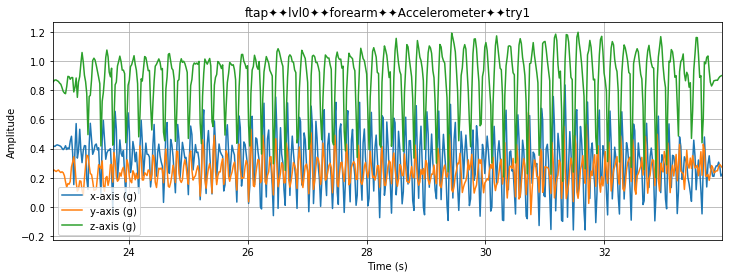

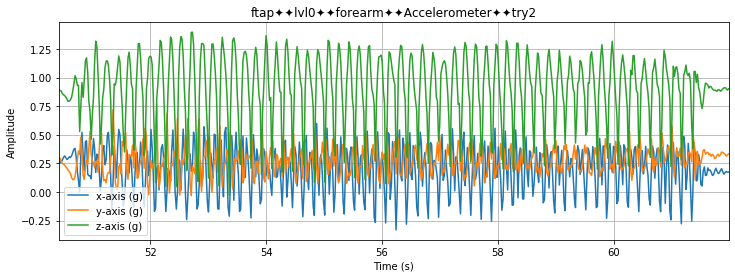

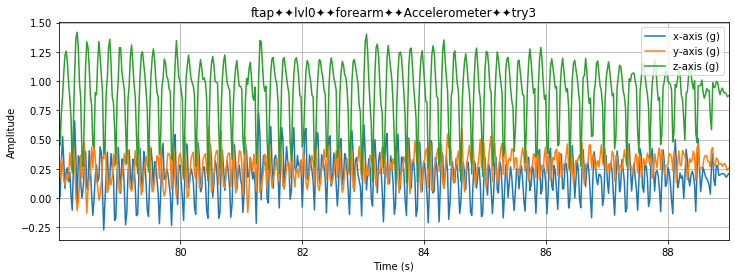

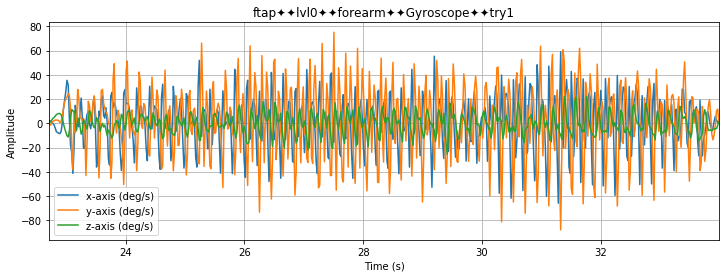

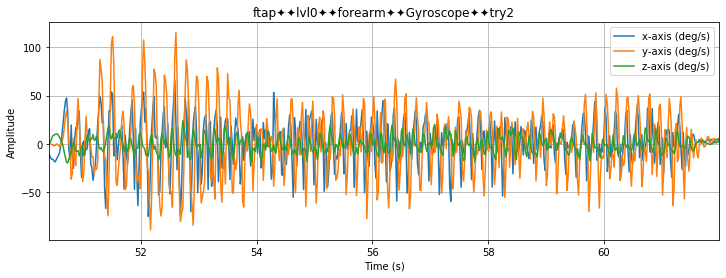

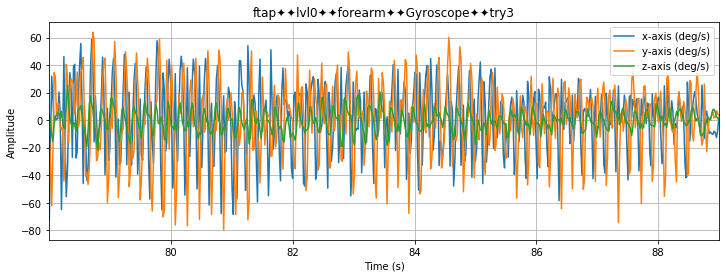

In [259]:
# proving if calcs is correct
def new_time():
    string,position,lvl,num1,num2,num3,num4,num5,num6 = trunc()
    
    for name in glob.glob('Motion Data/*.csv'):
        if (string in name):
            if (position in name) and (lvl in name):
                if True:
                    if ('Accelerometer' in name):
                        df = pd.read_csv(name)

                        t1,t2,t3 = df.loc[df['elapsed (s)'].between(num1,num2, inclusive=False)],df.loc[df['elapsed (s)'].between(num3,num4, inclusive=False)],df.loc[df['elapsed (s)'].between(num5,num6, inclusive=False)]
                        
                        oldname = name[12:-64].replace('_','')
                        newname1 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Accelerometer'
                        
                        ax1 = t1.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                      grid=True,figsize=(12,4), title=newname1+'\u2726''\u2726'+'try1')
                        ax1.set_xlabel('Time (s)')
                        ax1.set_ylabel('Amplitude')
                        
                        ax2 = t2.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                      grid=True,figsize=(12,4), title=newname1+'\u2726''\u2726'+'try2')
                        ax2.set_xlabel('Time (s)')
                        ax2.set_ylabel('Amplitude')
                        
                        ax3 = t3.plot(x='elapsed (s)', y=['x-axis (g)','y-axis (g)','z-axis (g)'], 
                                      grid=True,figsize=(12,4), title=newname1+'\u2726''\u2726'+'try3')
                        ax3.set_xlabel('Time (s)')
                        ax3.set_ylabel('Amplitude')
                        
                        L1 = t3['x-axis (g)'].values.tolist()
                        ar_t1_x = np.array(L1)
                        zcross_x = ((ar_t1_x[:-1] * ar_t1_x[1:]) < 0).sum()
                        L2 = t3['y-axis (g)'].values.tolist()
                        ar_t1_y = np.array(L2)
                        zcross_y = ((ar_t1_y[:-1] * ar_t1_y[1:]) < 0).sum()
                        L3 = t3['z-axis (g)'].values.tolist()
                        ar_t1_z = np.array(L3)
                        
                        mew1=mean(L1)
                        std1=np.std(L1)
                        mew2=mean(L2)
                        std2=np.std(L2)
                        mew3=mean(L3)
                        std3=np.std(L3)
                        print('Means:', mew1,mew2,mew3,'\n''Standard Deviations:',std1,std2,std3)
                        
                        xcrossings = []
                        for i in range(1, len(ar_t1_x)):
                            if ar_t1_x[i-1] < mew1 and ar_t1_x[i] >= mew1:
                                xcrossings.append(i)
                        ycrossings = []
                        for i in range(1, len(ar_t1_x)):
                            if ar_t1_y[i-1] < mew2 and ar_t1_y[i] >= mew2:
                                ycrossings.append(i)
                        zcrossings = []
                        for i in range(1, len(ar_t1_x)):
                            if ar_t1_z[i-1] < mew3 and ar_t1_z[i] >= mew3:
                                zcrossings.append(i)
                    
                        print("Mean crossing rates:", len(xcrossings), len(ycrossings), len(zcrossings),'\n')
                    
                    elif ('Gyroscope' in name):
                        df = pd.read_csv(name)
                          
                        t4,t5,t6 = df.loc[df['elapsed (s)'].between(num1,num2, inclusive=False)],df.loc[df['elapsed (s)'].between(num3,num4, inclusive=False)],df.loc[df['elapsed (s)'].between(num5,num6, inclusive=False)]
                        
                        oldname = name[12:-59].replace('_','')
                        newname2 = oldname.split('-')[0] + '\u2726''\u2726' + oldname.split('-')[1] + '\u2726''\u2726' + oldname.split('-')[2] + '\u2726''\u2726' + 'Gyroscope'

                        ax1 = t4.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                     grid=True,figsize=(12,4), title=newname2+'\u2726''\u2726'+'try1')
                        ax1.set_xlabel('Time (s)')
                        ax1.set_ylabel('Amplitude')
                        
                        ax2 = t5.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                      grid=True,figsize=(12,4), title=newname2+'\u2726''\u2726'+'try2')
                        ax2.set_xlabel('Time (s)')
                        ax2.set_ylabel('Amplitude')
                        
                        ax3 = t6.plot(x='elapsed (s)', y=['x-axis (deg/s)','y-axis (deg/s)','z-axis (deg/s)'], 
                                      grid=True,figsize=(12,4), title=newname2+'\u2726''\u2726'+'try3')
                        ax3.set_xlabel('Time (s)')
                        ax3.set_ylabel('Amplitude')
#                         print(t1,t2,t3,t4,t5,t6, sep='\n')
                        
                        L1 = t6['x-axis (deg/s)'].values.tolist()
                        ar_t4_x = np.array(L1)
                        zcross_x = ((ar_t4_x[:-1] * ar_t4_x[1:]) < 0).sum()
                        L2 = t6['y-axis (deg/s)'].values.tolist()
                        ar_t4_y = np.array(L2)
                        zcross_y = ((ar_t4_y[:-1] * ar_t4_y[1:]) < 0).sum()
                        L3 = t6['z-axis (deg/s)'].values.tolist()
                        ar_t4_z = np.array(L3)
                        zcross_z = ((ar_t4_z[:-1] * ar_t4_z[1:]) < 0).sum()
                        print("Zero-crossing rates:",zcross_x,zcross_y,zcross_z)
                        
                        mew4=mean(L1)
                        std4=np.std(L1)
                        mew5=mean(L2)
                        std5=np.std(L2)
                        mew6=mean(L3)
                        std6=np.std(L3)
                        print('Means:', mew4,mew5,mew6,'\n''Standard Deviations:',std4,std5,std6)
                        
                        xcrossings = []
                        for i in range(1, len(ar_t1_x)):
                            if ar_t4_x[i-1] < mew1 and ar_t4_x[i] >= mew1:
                                xcrossings.append(i)
                        ycrossings = []
                        for i in range(1, len(ar_t1_x)):
                            if ar_t4_y[i-1] < mew2 and ar_t4_y[i] >= mew2:
                                ycrossings.append(i)
                        zcrossings = []
                        for i in range(1, len(ar_t1_x)):
                            if ar_t4_z[i-1] < mew3 and ar_t4_z[i] >= mew3:
                                zcrossings.append(i)
                    
                        print("Mean crossing rates:", len(xcrossings), len(ycrossings), len(zcrossings),'\n')
                        
                        return mew1,mew2,mew3,mew4,mew5,mew6,std1,std2,std3,std4,std5,std6,ar_t1_x,ar_t1_y,ar_t1_z,ar_t4_x,ar_t4_y,ar_t4_z



def cov(x,y):    
    calc = []
    for i in range(len(x)):
        xi = x[i] - m4
        yi = y[i] - m6
    
        calc.append(xi * yi)
#         print(calc)
        
    return sum(calc)/(len(x) - 1), (sum(calc)/(len(x) - 1))/(s4*s5)

m1,m2,m3,m4,m5,m6,s1,s2,s3,s4,s5,s6,a1x,a1y,a1z,a4x,a4y,a4z = new_time()
a = a4x
b = a4z
print('Covariance:',cov(a,b))
